Based on http://www.scipy-lectures.org/advanced/image_processing/

In [1]:
from scipy import misc
import imageio
f = misc.face()
imageio.imwrite('face.png', f) # uses the Image module (PIL)

import matplotlib.pyplot as plt
plt.imshow(f)
plt.show()

In [2]:
face = imageio.imread('face.png')
type(face)      

imageio.core.util.Image

In [3]:
face.shape, face.dtype

((768, 1024, 3), dtype('uint8'))

In [4]:
import numpy as np
face.tofile('face.raw') # Create raw file
face_from_raw = np.fromfile('face.raw', dtype=np.uint8)
face_from_raw.shape

face_from_raw.shape = (768, 1024, 3)
type(face_from_raw) 

numpy.ndarray

In [5]:
face_memmap = np.memmap('face.raw', dtype=np.uint8, shape=(768, 1024, 3))

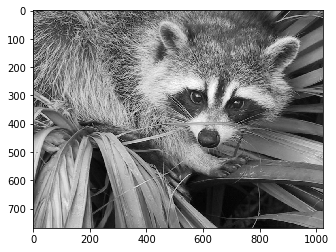

In [6]:
f = misc.face(gray=True)  # retrieve a grayscale image
import matplotlib.pyplot as plt
plt.imshow(f, cmap=plt.cm.gray)  

(-0.5, 1023.5, 767.5, -0.5)

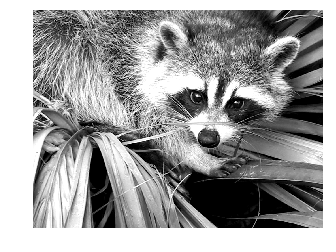

In [7]:
plt.imshow(f, cmap=plt.cm.gray, vmin=30, vmax=200)        

# Remove axes and ticks
plt.axis('off')

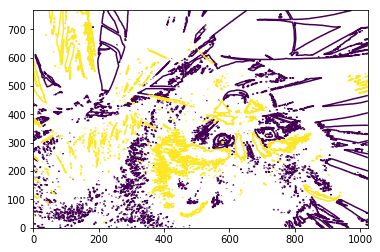

In [8]:
plt.contour(f, [50, 200]) 

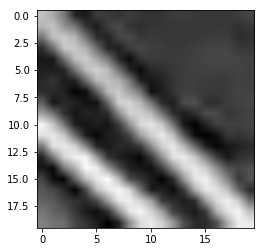

In [9]:
plt.imshow(f[320:340, 510:530], cmap=plt.cm.gray, interpolation='bilinear')        

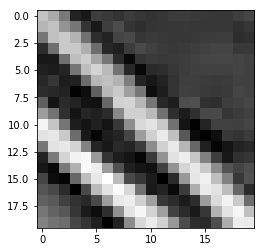

In [10]:
plt.imshow(f[320:340, 510:530], cmap=plt.cm.gray, interpolation='nearest')  

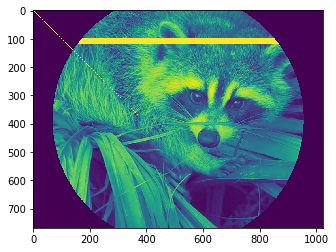

In [11]:
face = misc.face(gray=True)
face[0, 40]

# Slicing
face[10:13, 20:23]



face[100:120] = 255

lx, ly = face.shape
X, Y = np.ogrid[0:lx, 0:ly]
mask = (X - lx / 2) ** 2 + (Y - ly / 2) ** 2 > lx * ly / 4
# Masks
face[mask] = 0
# Fancy indexing
face[range(400), range(400)] = 255
plt.imshow(face)
plt.show()

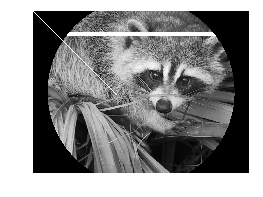

In [12]:
import numpy as np
import scipy
import scipy.misc
import matplotlib.pyplot as plt

face = scipy.misc.face(gray=True)
face[10:13, 20:23]
face[100:120] = 255

lx, ly = face.shape
X, Y = np.ogrid[0:lx, 0:ly]
mask = (X - lx/2)**2 + (Y - ly/2)**2 > lx*ly/4
face[mask] = 0
face[range(400), range(400)] = 255

plt.figure(figsize=(3, 3))
plt.axes([0, 0, 1, 1])
plt.imshow(face, cmap=plt.cm.gray)
plt.axis('off')

plt.show()

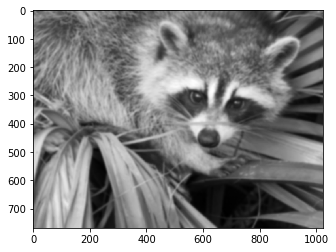

In [13]:
from scipy import ndimage
face = misc.face(gray=True)
blurred_face = ndimage.gaussian_filter(face, sigma=3)
plt.imshow(blurred_face, cmap=plt.cm.gray)

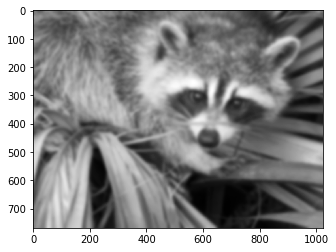

In [14]:
very_blurred = ndimage.gaussian_filter(face, sigma=5)
plt.imshow(very_blurred, cmap=plt.cm.gray)

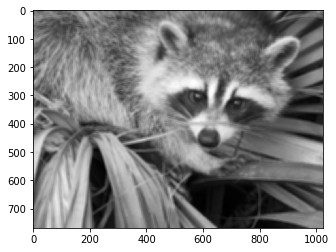

In [15]:
local_mean = ndimage.uniform_filter(face, size=11)
plt.imshow(local_mean, cmap=plt.cm.gray)

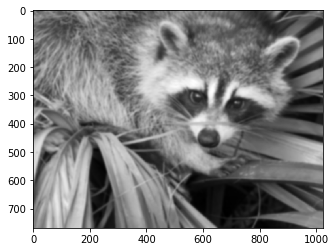

In [16]:
face = misc.face(gray=True).astype(float)
blurred_f = ndimage.gaussian_filter(face, 3)
plt.imshow(blurred_f, cmap=plt.cm.gray)

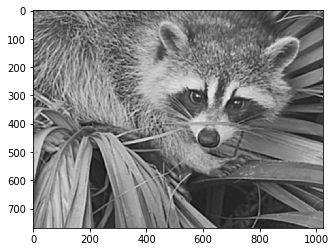

In [17]:
filter_blurred_f = ndimage.gaussian_filter(blurred_f, 1)
alpha = 30
sharpened = blurred_f + alpha * (blurred_f - filter_blurred_f)
plt.imshow(sharpened,cmap=plt.cm.gray)

Starting at this point, the following work will be my own:

In [18]:
face_from_raw.shape

(768, 1024, 3)

In [19]:
face_from_raw2 = np.copy(face_from_raw)

In [20]:
darklight = (255*3)/2

In [69]:
def calculate (ffr, i, j):
    initial = sum(ffr[i][j])
    lightcount = 0
    darkcount = 0
    for k in {-1,0,1}:
        if (i+k >=0) and (i+k < ffr.shape[0]):
            for w in {-1,0,1}:
                if (j+w >=0) and (j+w <  ffr.shape[1]):
                    if sum(ffr[i+k][j+w]) <= darklight:
                        darkcount = darkcount +1
                    else:
                        lightcount = lightcount +1
    
    if(initial <= darklight):
        return lightcount > darkcount
    else:
        return darkcount > lightcount
                        
    

In [70]:
import time

In [73]:
def functiona (times, fpic):
    ffr = np.copy(fpic)
    i = 0
    while i < face_from_raw.shape[0]:
        j = 0
        while j < face_from_raw.shape[1]:
            lives = calculate(ffr,i,j)
            if not lives:
                fpic[i][j] = 255 - fpic[i][j]
            j = j+1
        i = i+1
    plt.imshow(fpic)
    plt.show()
    if (times>0):
        functiona(times-1,fpic)

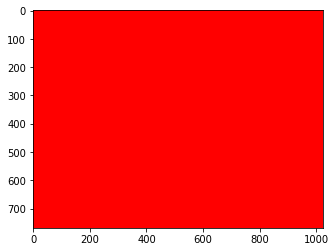

KeyboardInterrupt: 

In [72]:
functiona(5, face_from_raw2)

In [25]:
255 - 138

117

In [65]:
def functiona2 (times, fpic):
    ffr = np.copy(fpic)
    i = 0
    print(ffr.shape)
    print(ffr.shape[0])
    print("-------------")
    print(ffr[1][0])
    print(fpic[1][0])
    print("-------------")
    while i < ffr.shape[0]:
        j = 0
        while j < ffr.shape[1]:
            #lives = calculate(ffr,i,j)
            fpic[i][j] = [255, 0, 0]#255 - fpic[i][j]
            #print(str(i) + " "+ str(j))
            #print(fpic)
            j = j+1
        #print("tus muertos home ya po enga po ea "+str(i))
        i = i+1
    plt.imshow(fpic)
    print(fpic[1][0])
    plt.show()

(768, 1024, 3)
768
-------------
[ 89  82 100]
[ 89  82 100]
-------------
[255   0   0]


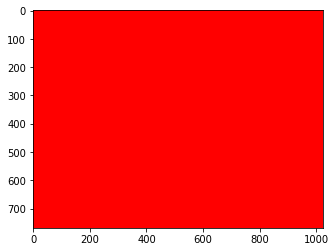

In [66]:
functiona2(5, face_from_raw2)

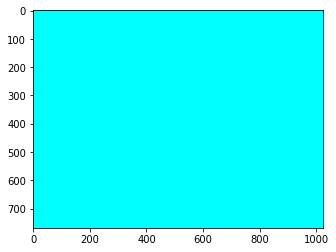

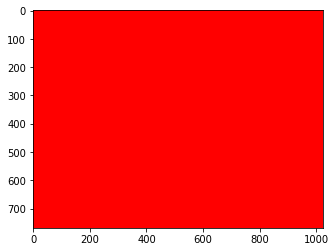

In [74]:
functiona(1, face_from_raw2)

In [75]:
face_from_raw2 = np.copy(face_from_raw)

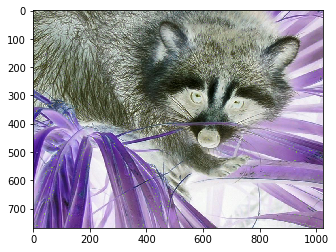

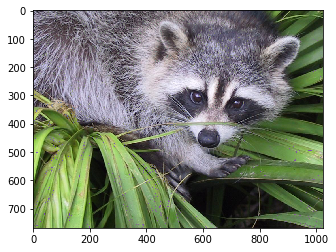

In [76]:
functiona(1, face_from_raw2)

In [77]:
def calculate2 (ffr, i, j):
    initial = sum(ffr[i][j])
    lightcount = 0
    darkcount = 0
    print(initial)
    for k in {-1,0,1}:
        if (i+k >=0) and (i+k < ffr.shape[0]):
            for w in {-1,0,1}:
                if (j+w >=0) and (j+w <  ffr.shape[1]):
                    if sum(ffr[i+k][j+w]) <= darklight:
                        darkcount = darkcount +1
                    else:
                        lightcount = lightcount +1
    print(str(lightcount) +" "+str(darkcount))
    if(initial <= darklight):
        return lightcount <= darkcount
    else:
        return darkcount <= lightcount
                        
    

In [78]:
calculate2(face_from_raw2,1,1)

334
3 6


False

In [79]:
darklight

382.5

In [83]:
def calculate (ffr, i, j):
    initial = sum(ffr[i][j])
    lightcount = 0
    darkcount = 0
    for k in {-1,0,1}:
        if (i+k >=0) and (i+k < ffr.shape[0]):
            for w in {-1,0,1}:
                if (j+w >=0) and (j+w <  ffr.shape[1]):
                    if sum(ffr[i+k][j+w]) <= darklight:
                        darkcount = darkcount +1
                    else:
                        lightcount = lightcount +1
    
    if(initial > darklight):
        return lightcount >= darkcount
    else:
        return darkcount >= lightcount

In [95]:
def functiona (times, fpic):
    ffr = np.copy(fpic)
    i = 0
    pop = 0
    while i < face_from_raw.shape[0]:
        j = 0
        while j < face_from_raw.shape[1]:
            lives = calculate(ffr,i,j)
            if not lives:
                pop = pop + 1
                fpic[i][j] = 255 - fpic[i][j]
            j = j+1
        i = i+1
    plt.imshow(fpic)
    plt.show()
    print(pop)
    if (times>0):
        functiona(times-1,fpic)

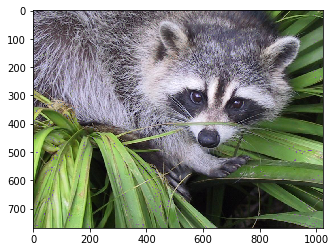

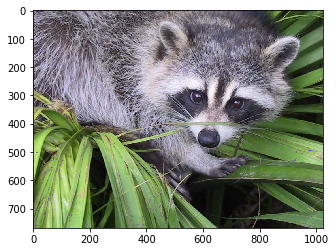

In [82]:
functiona(1, face_from_raw2)

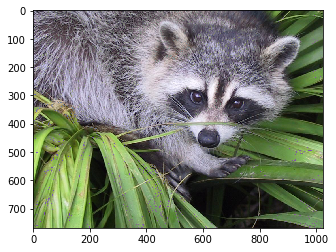

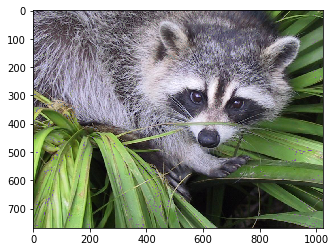

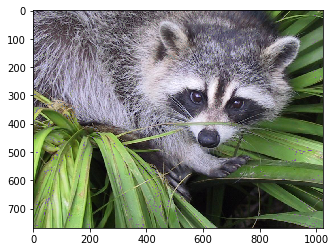

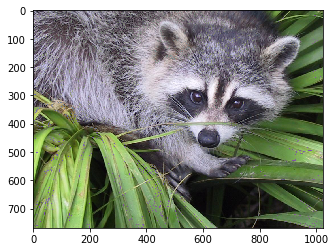

In [85]:
functiona(3, face_from_raw2)

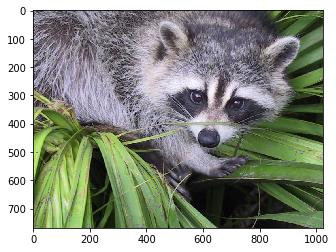

900


In [87]:
functiona(0, face_from_raw2)

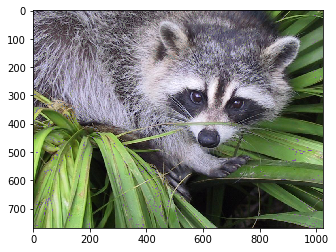

697


In [88]:
functiona(0, face_from_raw2)

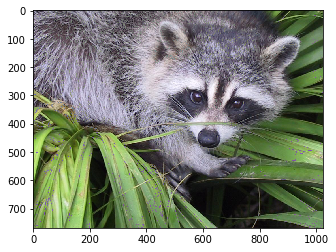

555


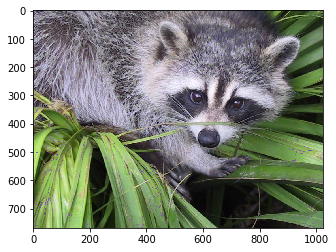

469


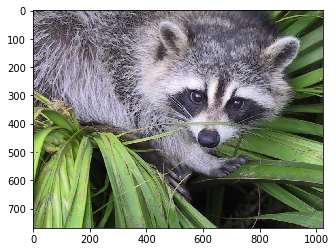

391


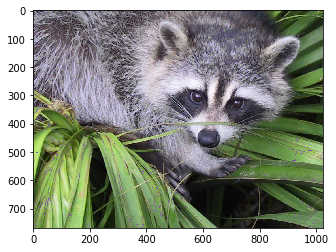

335


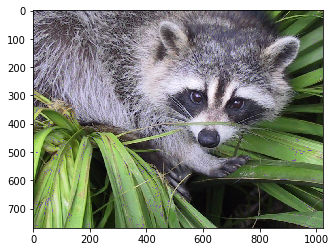

298


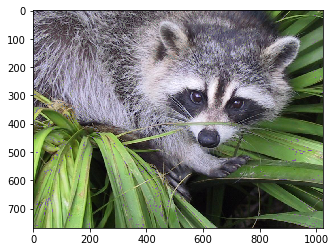

242


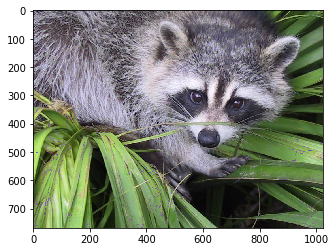

200


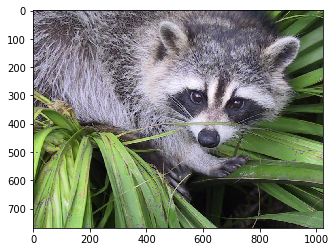

171


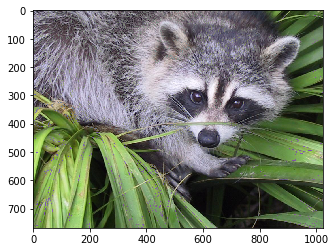

145


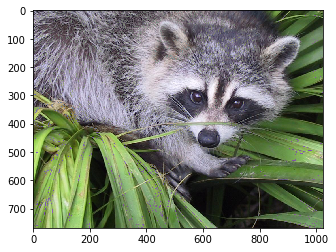

131


KeyboardInterrupt: 

In [89]:
functiona(20, face_from_raw2)

In [94]:
def calculate (ffr, i, j):
    initial = sum(ffr[i][j])
    lightcount = 0
    darkcount = 0
    for k in {-1,0,1}:
        if (i+k >=0) and (i+k < ffr.shape[0]):
            for w in {-1,0,1}:
                if (j+w >=0) and (j+w <  ffr.shape[1]):
                    if sum(ffr[i+k][j+w]) <= darklight:
                        darkcount = darkcount +1
                    else:
                        lightcount = lightcount +1
    
    if(initial > darklight):
        return (lightcount >= darkcount) and lightcount <7
    else:
        return darkcount >= lightcount and darkcount <7

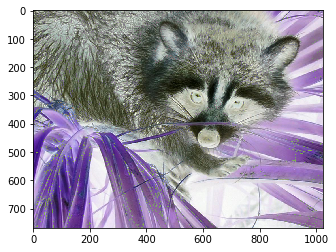

769802


In [92]:
functiona(0, face_from_raw2)

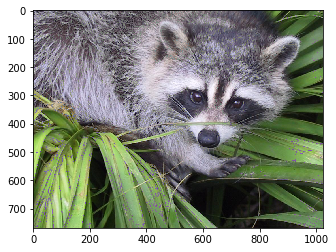

775428
CPU times: user 38.2 s, sys: 1.02 s, total: 39.2 s
Wall time: 37.9 s


In [93]:
%%time
functiona(0, face_from_raw2)

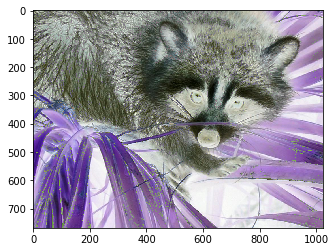

754633


In [96]:
functiona(0, face_from_raw2)

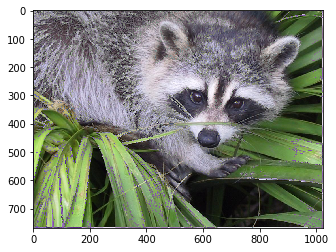

753658


In [97]:
functiona(0, face_from_raw2)

In [107]:
def calculatealt (ffr, i, j):
    initial = sum(ffr[i][j])
    lightcount = 0
    darkcount = 0
    for k in {-1,0,1}:
        if (i+k >=0) and (i+k < ffr.shape[0]):
            for w in {-1,0,1}:
                if (j+w >=0) and (j+w <  ffr.shape[1]):
                    if sum(ffr[i+k][j+w]) <= darklight:
                        darkcount = darkcount +1
                    else:
                        lightcount = lightcount +1
    
    if(initial > darklight):
        return darkcount>=6
    else:
        return lightcount>=6

In [112]:
def functionalt (times, fpic):
    ffr = np.copy(fpic)
    i = 0
    pop = 0
    while i < face_from_raw.shape[0]:
        j = 0
        while j < face_from_raw.shape[1]:
            lives = calculatealt(ffr,i,j)
            if not lives:
                pop = pop + 1
                fpic[i][j] = 255 - fpic[i][j]
            j = j+1
        i = i+1
    plt.imshow(fpic)
    plt.show()
    print(pop)
    if (times>0):
        functiona(times-1,fpic)

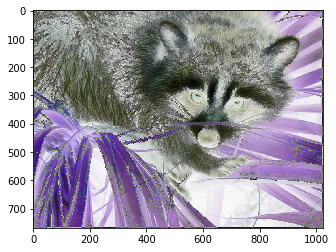

743745
CPU times: user 37.5 s, sys: 680 ms, total: 38.1 s
Wall time: 37.5 s


In [100]:
%%time
functionalt(0, face_from_raw2)

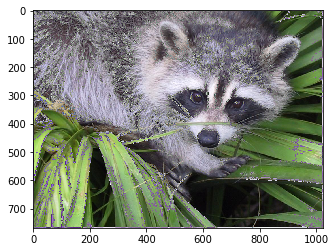

720174
CPU times: user 36.7 s, sys: 620 ms, total: 37.3 s
Wall time: 36.3 s


In [103]:
%%time
functionalt(0, face_from_raw2)

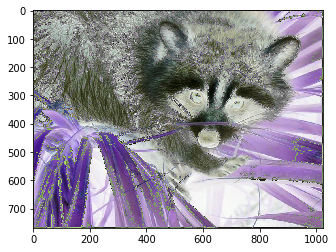

712236
CPU times: user 37.4 s, sys: 820 ms, total: 38.2 s
Wall time: 37.2 s


In [106]:
%%time
functionalt(0, face_from_raw2)

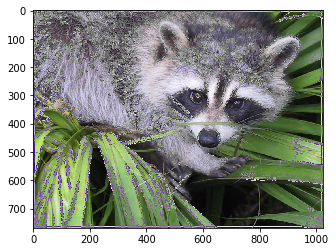

699471
CPU times: user 37.6 s, sys: 684 ms, total: 38.2 s
Wall time: 37.3 s


In [108]:
%%time
functionalt(0, face_from_raw2)

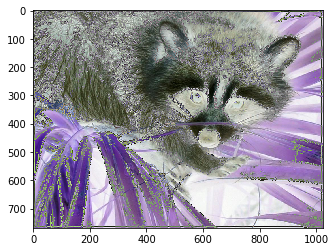

694959


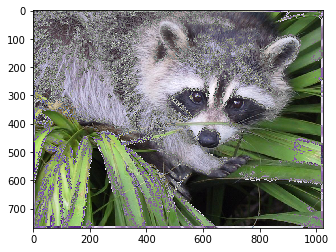

680720
CPU times: user 1min 14s, sys: 1.3 s, total: 1min 16s
Wall time: 1min 14s


In [109]:
%%time
functionalt(1, face_from_raw2)

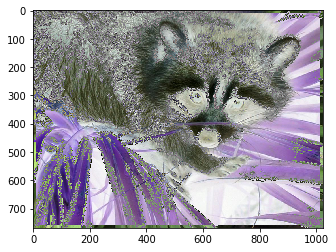

681690


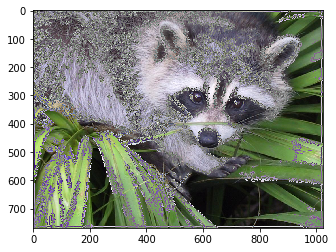

667767


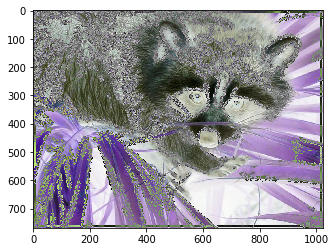

660182


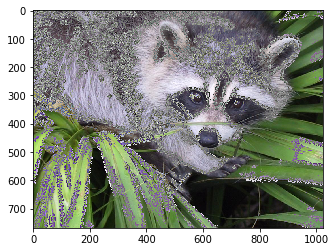

647820


KeyboardInterrupt: 

In [110]:
%%time
functionalt(9, face_from_raw2)

In [115]:
def calculatealt (ffr, i, j):
    initial = sum(ffr[i][j])
    lightcount = 0
    darkcount = 0
    for k in {-1,0,1}:
        if (i+k >=0) and (i+k < ffr.shape[0]):
            for w in {-1,0,1}:
                if (j+w >=0) and (j+w <  ffr.shape[1]):
                    if sum(ffr[i+k][j+w]) <= darklight:
                        darkcount = darkcount +1
                    else:
                        lightcount = lightcount +1
    
    if(initial < darklight):
        return darkcount>=6
    else:
        return lightcount>=6

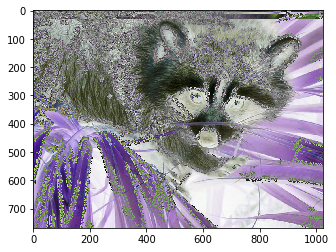

743521


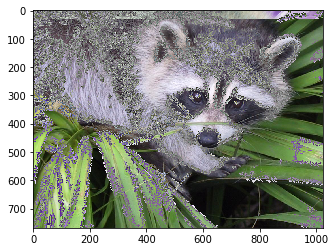

679402


KeyboardInterrupt: 

In [114]:
%%time
functionalt(9, face_from_raw2)

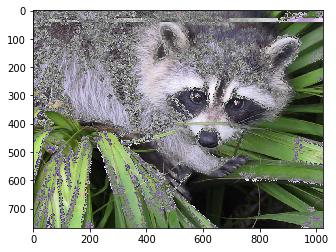

137528
CPU times: user 34.2 s, sys: 32 ms, total: 34.2 s
Wall time: 34.1 s


In [116]:
%%time
functionalt(0, face_from_raw2)

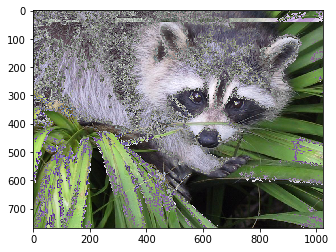

95308


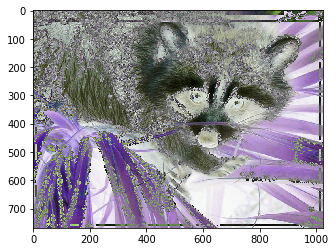

720492


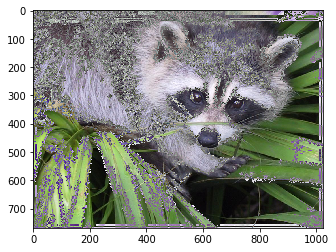

698732


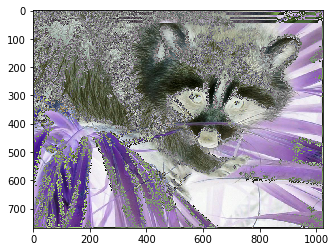

676080


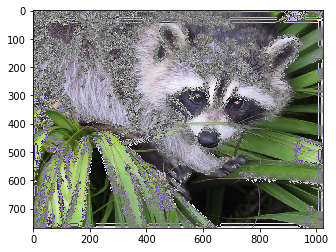

654291


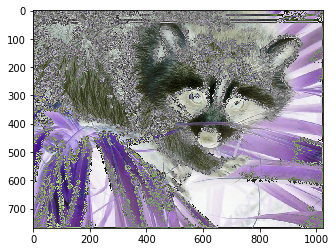

646454


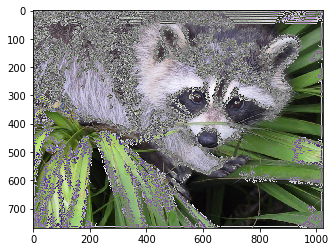

635598


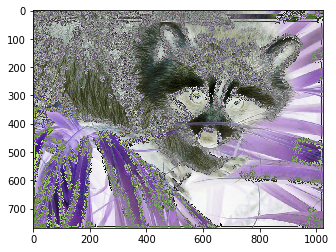

627897


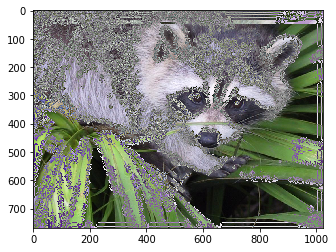

623362


KeyboardInterrupt: 

In [117]:
%%time
functionalt(9, face_from_raw2)

In [118]:
def functionalt (times, fpic):
    ffr = np.copy(fpic)
    i = 0
    pop = 0
    while i < face_from_raw.shape[0]:
        j = 0
        while j < face_from_raw.shape[1]:
            lives = calculatealt(ffr,i,j)
            if not lives:
                pop = pop + 1
                fpic[i][j] = 255 - fpic[i][j]
            j = j+1
        i = i+1
    plt.imshow(fpic)
    plt.show()
    print(pop)
    if (times>0):
        functionalt(times-1,fpic)

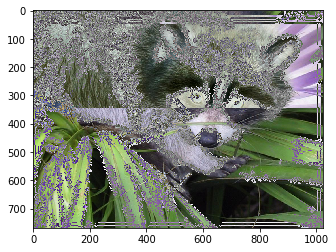

193075


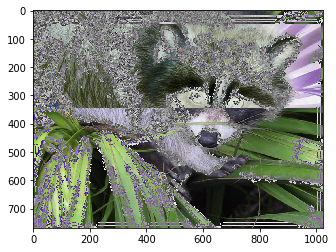

149092


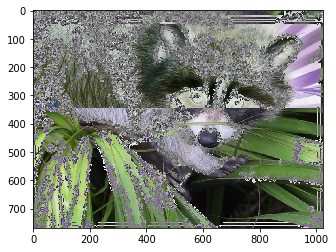

118850


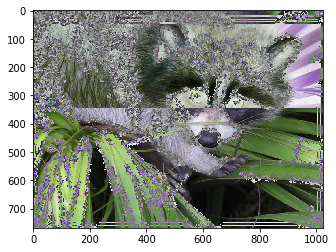

98544


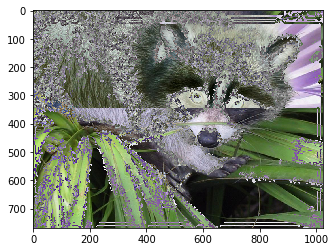

84263


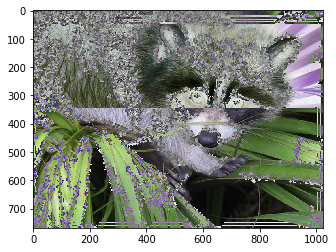

74614


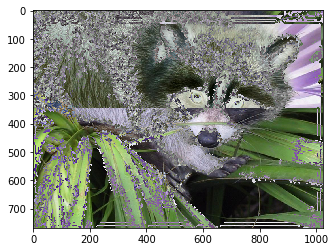

67863


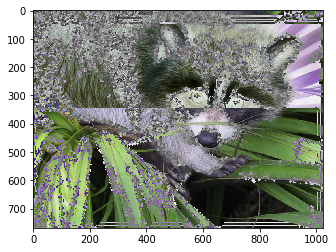

63425


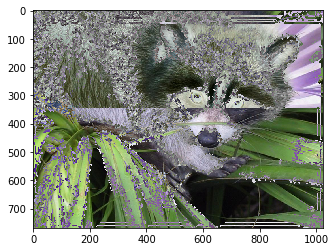

60408


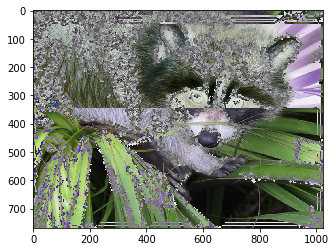

58350
CPU times: user 5min 41s, sys: 368 ms, total: 5min 41s
Wall time: 5min 40s


In [119]:
%%time
functionalt(9, face_from_raw2)

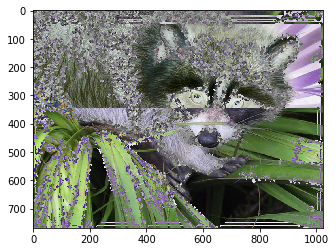

56993


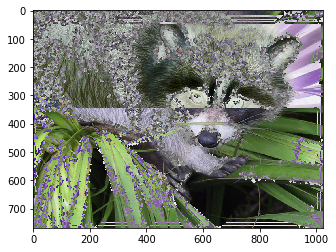

56113


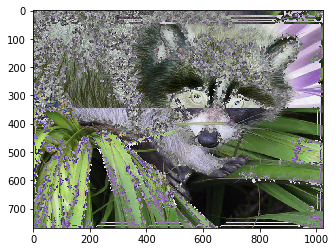

55505


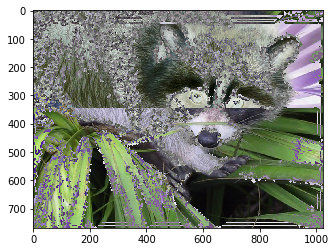

55084


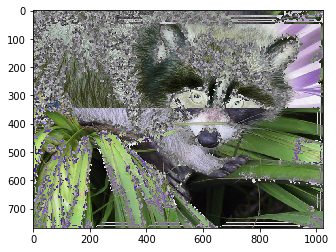

54814


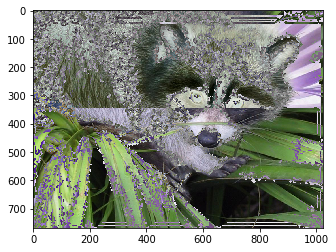

54613


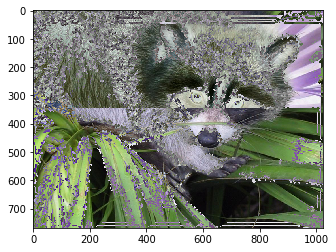

54477


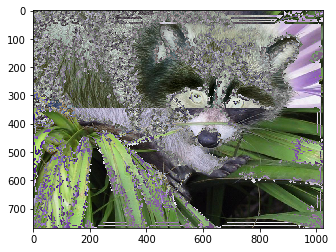

54399


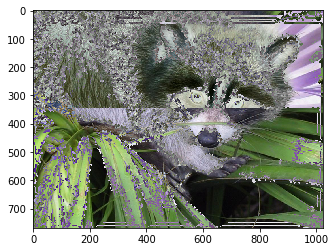

54372


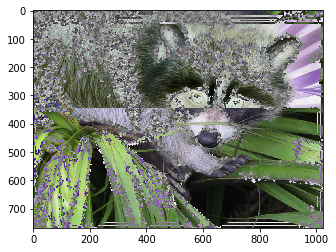

54365


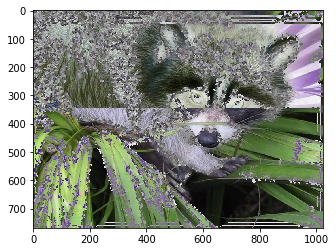

54384


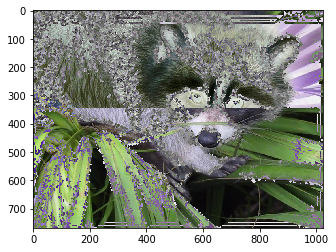

54413


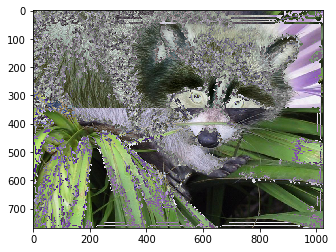

54457


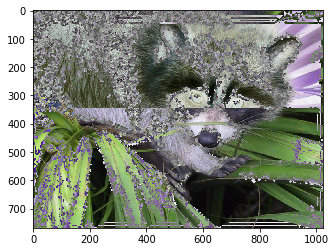

54495


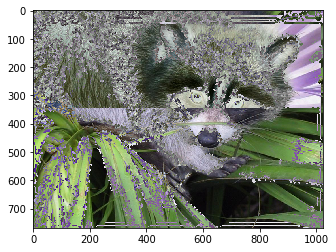

54543


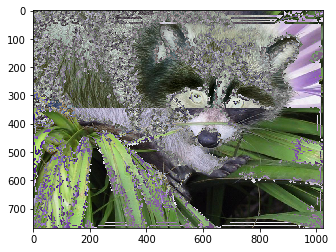

54594


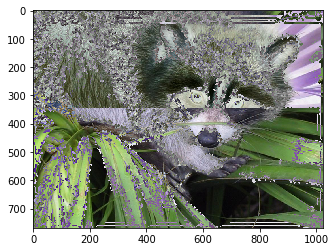

54653


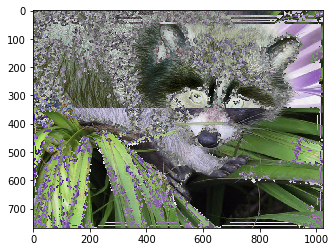

54714


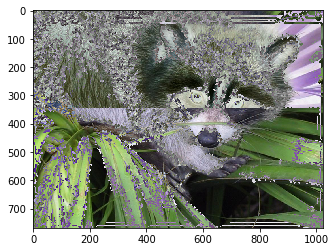

54777


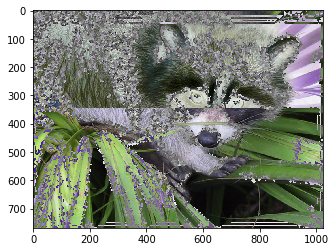

54840


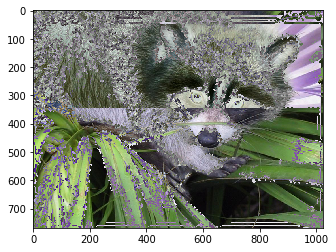

54909


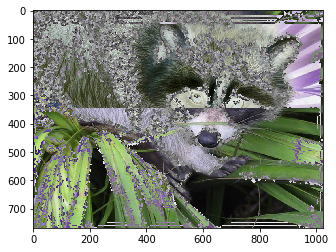

54975


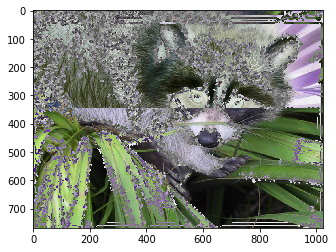

55042


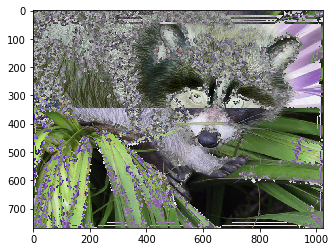

55110


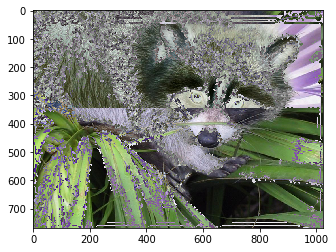

55177


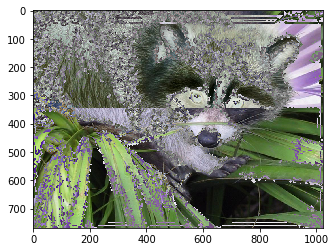

55242


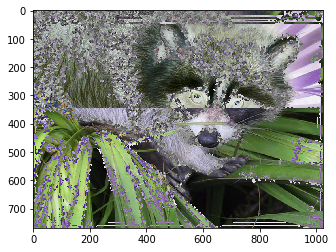

55308


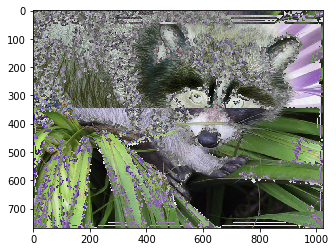

55375


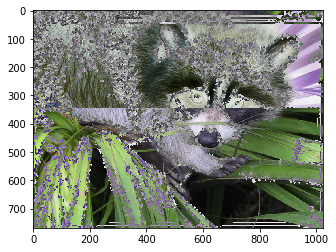

55438


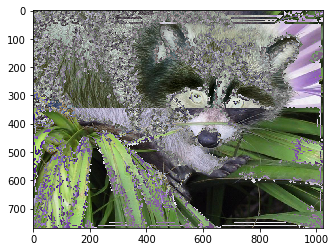

55501


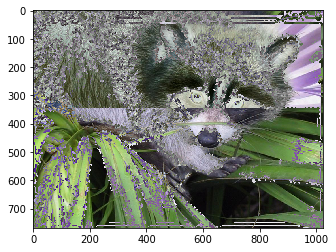

55558


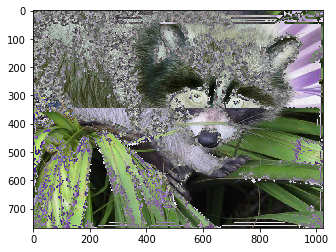

55615


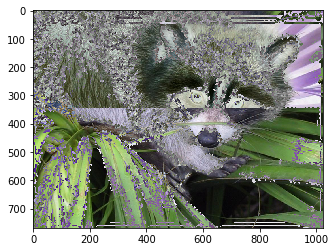

55672


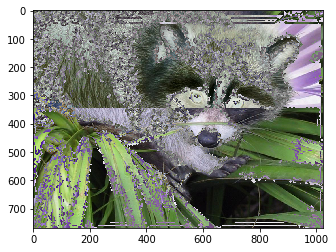

55727


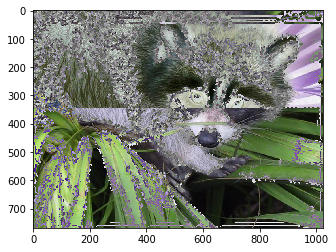

55782


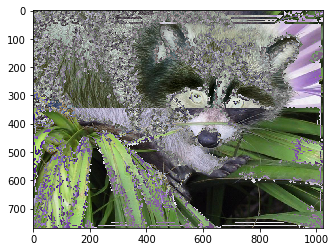

55836


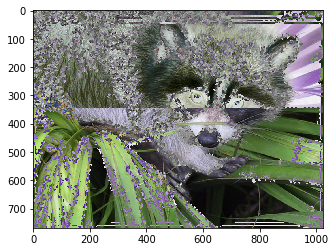

55889


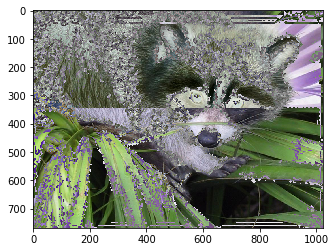

55942


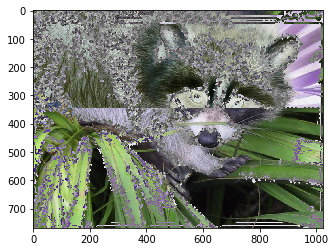

55995


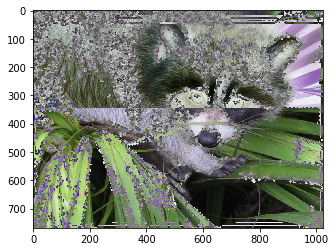

56048


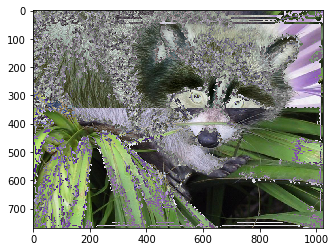

56101


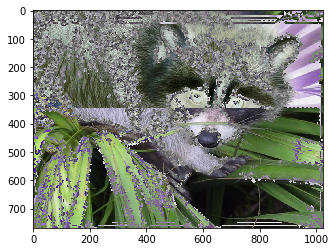

56154


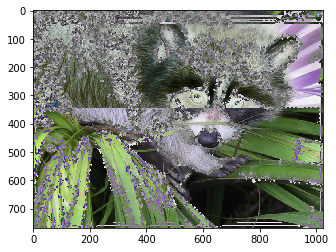

56207


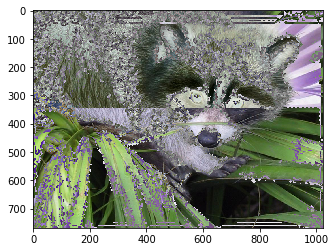

56260


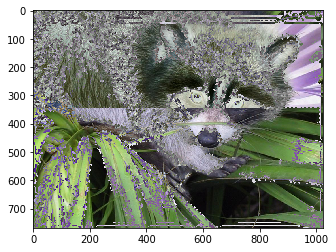

56312


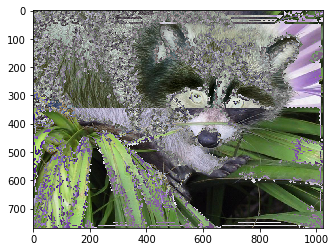

56357


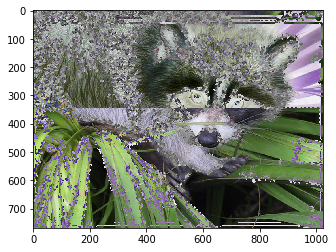

56399


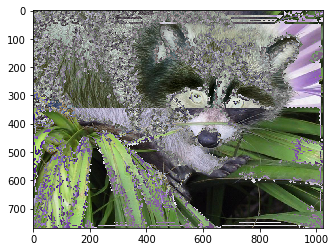

56444


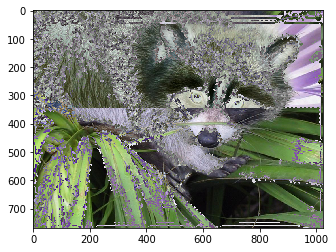

56490


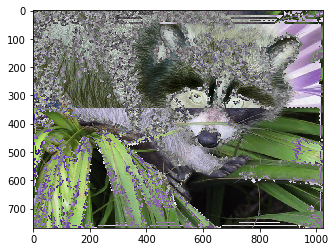

56535


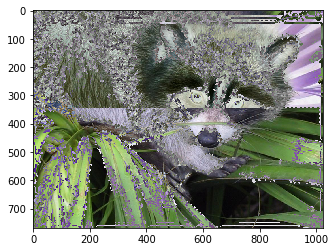

56578


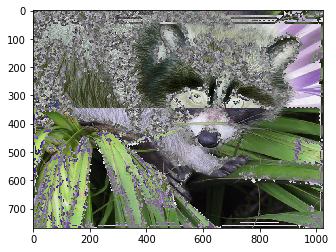

56613


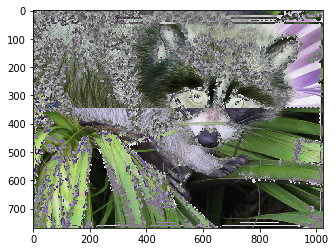

56646


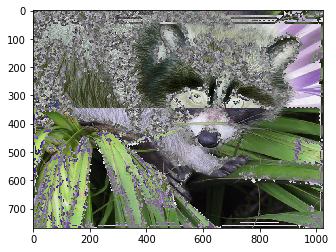

56675


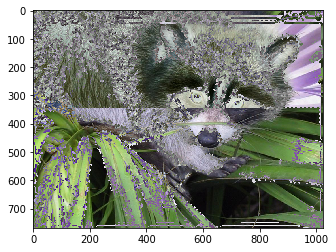

56698


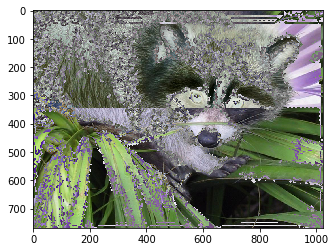

56721


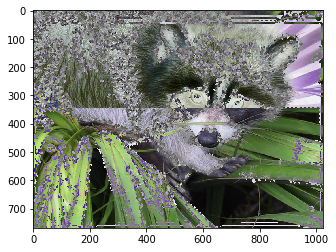

56744


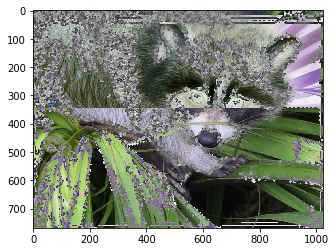

56767


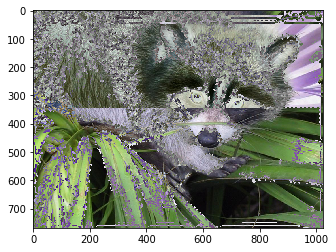

56790


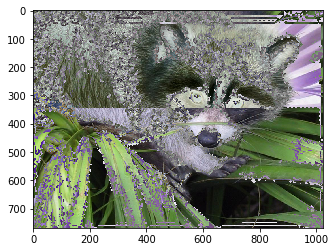

56813


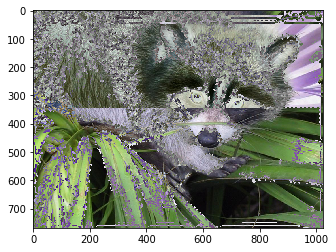

56836


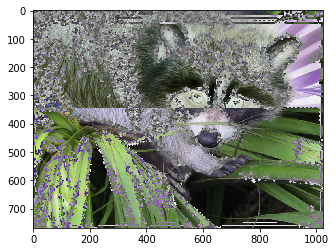

56859


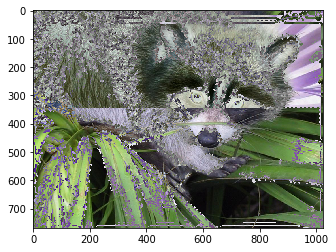

56880


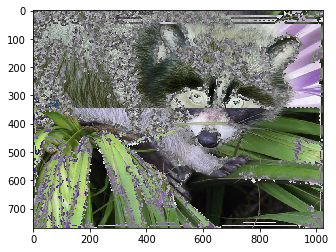

56899


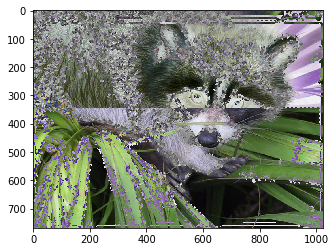

56914


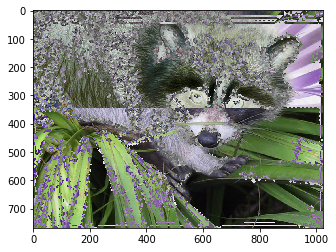

56930


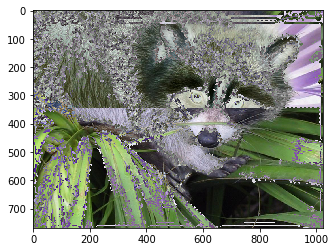

56945


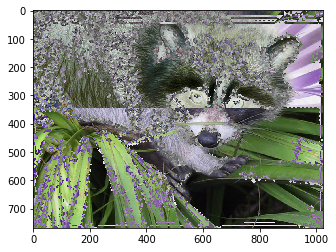

56960


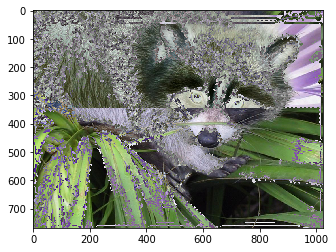

56977


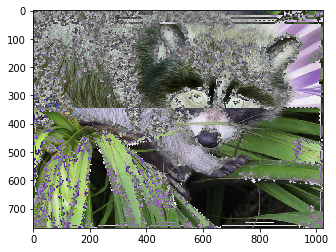

56993


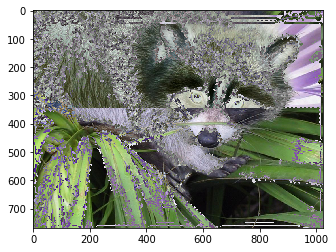

57006


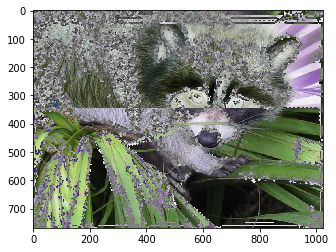

57019


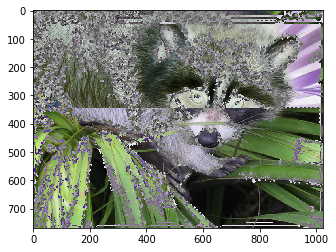

57032


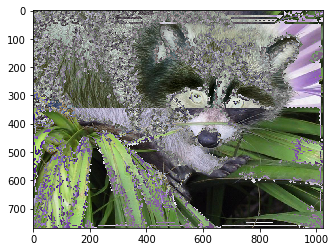

57045


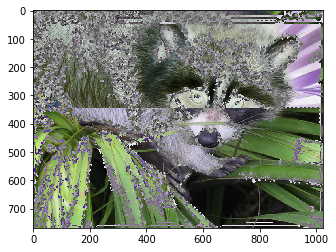

57058


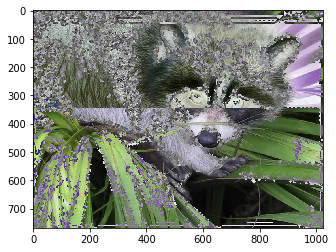

57071


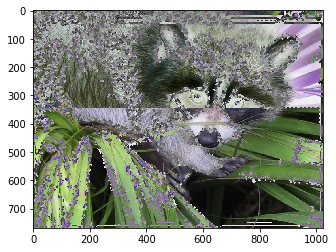

57084


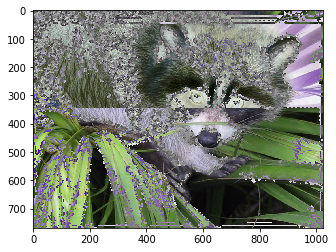

57097


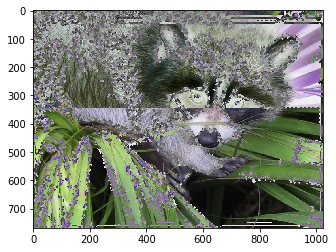

57110


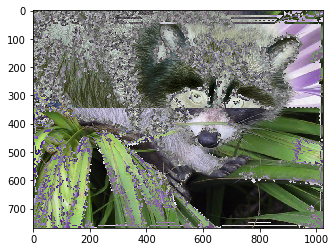

57123


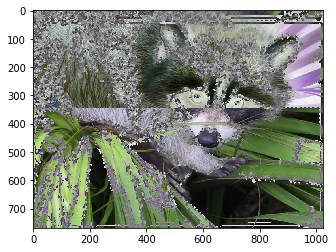

57136


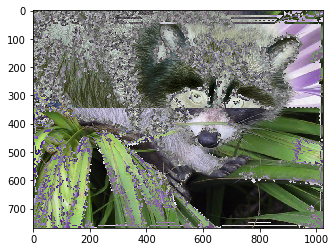

57149


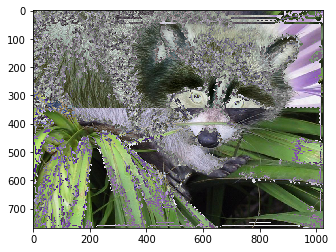

57162


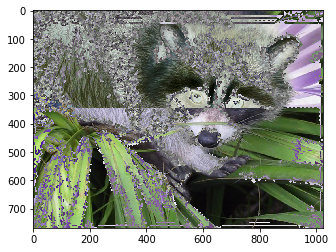

57175


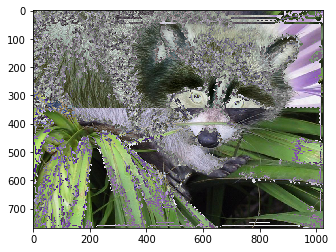

57188


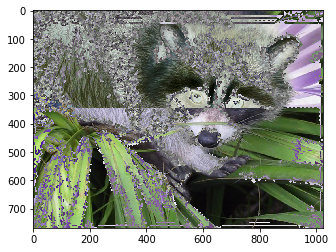

57201


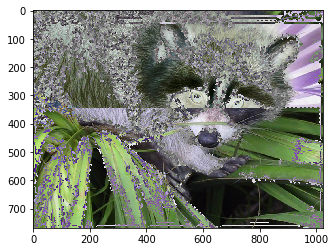

57214


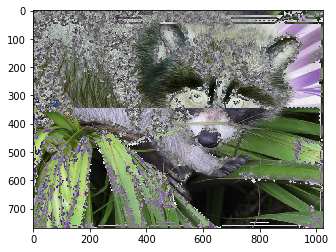

57227


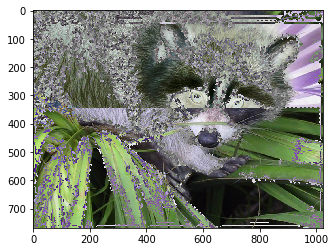

57237


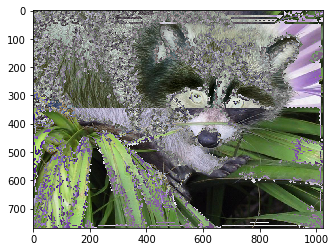

57246


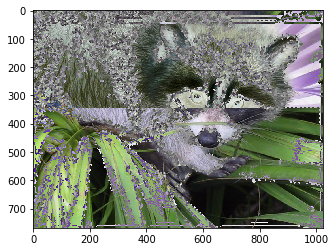

57255


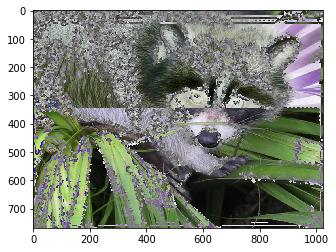

57264


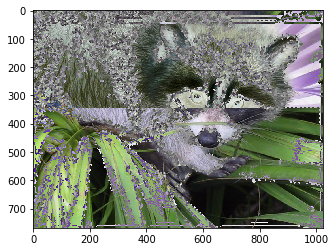

57273


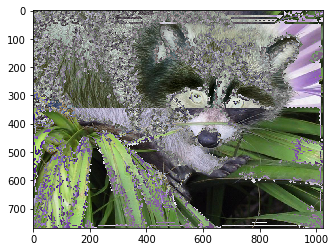

57280


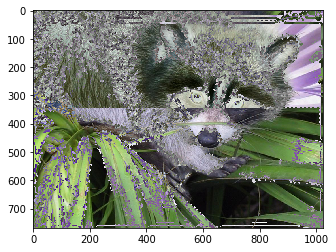

57287


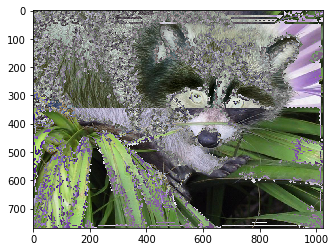

57292


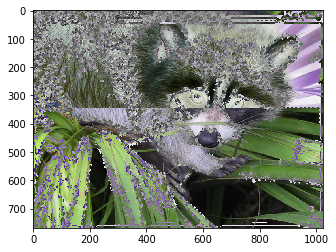

57297


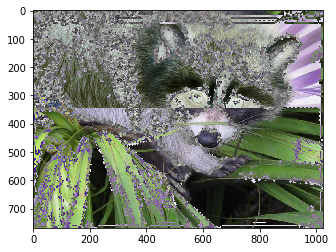

57302


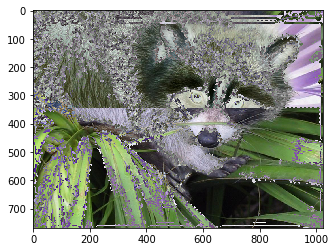

57307


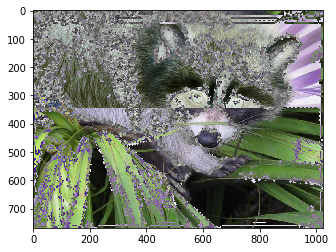

57312
CPU times: user 56min 36s, sys: 3.62 s, total: 56min 39s
Wall time: 56min 29s


In [120]:
%%time
functionalt(99, face_from_raw2)

In [121]:
face_from_raw2.tofile('facefromraw2.raw') # Create raw file